# Lien entre performance énergétique des logements (DPE) et niveau de vie des ménages

## Une analyse à l'échelle des communes d'Ile-de-France

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

### 1- Récupération des données

#### Données de l'ADEME

In [22]:
import requests
import gzip

# Définition d'une fonction permettant de lire les données au format gz
def lecteur(url):
    
    # téléchargement du fichier
    filename = url.split("/")[-1]
    with open(filename, "wb") as f:
        r = requests.get(url)
        f.write(r.content)
        
    # lecture du data_frame
    with gzip.open(filename) as f:
         return(pd.read_csv(f))

In [23]:
data1 = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-40/data-files/dep_40.csv.gz")
data1.head()

/tmp/ipykernel_102480/2943421465.py:15: DtypeWarning: Columns (27,35,36,37,39,43,76,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  return(pd.read_csv(f))


,id,numero_dpe,usr_diagnostiqueur_id,usr_logiciel_id,tr001_modele_dpe_id,nom_methode_dpe,version_methode_dpe,nom_methode_etude_thermique,version_methode_etude_thermique,date_visite_diagnostiqueur,...,tv017_zone_hiver_code,tv017_zone_hiver_t_ext_moyen,tv017_zone_hiver_peta_cw,tv017_zone_hiver_dh14,tv017_zone_hiver_prs1,tv018_zone_ete_code,tv018_zone_ete_sclim_inf_150,tv018_zone_ete_sclim_sup_150,tv018_zone_ete_rclim_autres_etages,tv018_zone_ete_rclim_dernier_etage
0,537,1340V1000001U,6066,3,1,Méthode 3CL,"3CL-DPE, version 1.3",NaN,NaN,2013-04-16,...,H2,8.08,12.0,33300,3.4,Ec,4,6,3.0,4
1,844,1340V1000002V,1369,3,1,Méthode 3CL,"3CL-DPE, version 1.3",NaN,NaN,2013-04-12,...,H2,8.08,12.0,33300,3.4,Ec,4,6,3.0,4
2,850,1340L1000001T,6800,3,9,Méthode 3CL,"3CL-DPE, version 1.3",NaN,NaN,2013-04-09,...,H2,8.08,12.0,33300,3.4,Ec,4,6,3.0,4
3,921,1340V1000003W,6066,3,1,Méthode 3CL,"3CL-DPE, version 1.3",NaN,NaN,2013-04-19,...,H2,8.08,12.0,33300,3.4,Ec,4,6,3.0,4
4,1265,1340V1000004X,6066,3,1,Méthode 3CL,"3CL-DPE, version 1.3",NaN,NaN,2013-04-23,...,H2,8.08,12.0,33300,3.4,Ec,4,6,3.0,4


In [24]:
Paris = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-75/data-files/dep_75.csv.gz")
Seine_et_Marne = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-77/data-files/dep_77.csv.gz")
Yvelines = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-78/data-files/dep_78.csv.gz")
Essonne = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-91/data-files/dep_91.csv.gz")
Hauts_de_Seine = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-92/data-files/dep_92.csv.gz")
Seine_saint_Denis = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-93/data-files/dep_93.csv.gz")
Val_de_Marne = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-94/data-files/dep_94.csv.gz")
Val_Oise = lecteur("https://koumoul.com/data-fair/api/v1/datasets/dpe-95/data-files/dep_95.csv.gz")

/tmp/ipykernel_102480/2943421465.py:15: DtypeWarning: Columns (8,35,36,37,43,76,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  return(pd.read_csv(f))
/tmp/ipykernel_102480/2943421465.py:15: DtypeWarning: Columns (8,13,19,27,31,34,35,36,37,39,43,76,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  return(pd.read_csv(f))
/tmp/ipykernel_102480/2943421465.py:15: DtypeWarning: Columns (35,36,37,43,76,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  return(pd.read_csv(f))
/tmp/ipykernel_102480/2943421465.py:15: DtypeWarning: Columns (35,36,37,43,76,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  return(pd.read_csv(f))
/tmp/ipykernel_102480/2943421465.py:15: DtypeWarning: Columns (35,36,37,43,92,93,94) have mixed types. Specify dtype option on import or set low_memory=False.
  return(pd.read_csv(f))
/tmp/ipykernel_102480/2943421465.py:15: DtypeW

In [26]:
DPE_IDF=pd.concat([Paris,Seine_et_Marne,Yvelines,Essonne,Hauts_de_Seine,Seine_saint_Denis,Val_de_Marne,Val_Oise])
DPE_IDF.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1704653 entries, 0 to 176089
Columns: 131 entries, id to tv018_zone_ete_rclim_dernier_etage
dtypes: float64(49), int64(28), object(54)
memory usage: 1.7+ GB


In [28]:
DPE_IDF.shape

(1704653, 131)

In [25]:
# Récupération des données de l'ADEME portant sur la performance énergétique des logements résidentiels situés dans
# les 8 départements d'Ile-de-France:
#Paris=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-75/data-files/dpe-75.csv")
#Seine_et_Marne=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-77/data-files/dpe-77.csv")
#Yvelines=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-78/data-files/dpe-78.csv")
#Essonne=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-91/data-files/dpe-91.csv")
#Hauts_de_Seine=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-92/data-files/dpe-92.csv")
#Seine_saint_Denis=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-93/data-files/dpe-93.csv")
#Val_de_Marne=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-94/data-files/dpe-94.csv")
#Val_Oise=pd.read_csv("https://koumoul.com/data-fair/api/v1/datasets/dpe-95/data-files/dpe-95.csv")

In [31]:
# On restreint le dadatframe DPE_IDF aux variables pertinentes pour notre analyse:
DPE_IDF=DPE_IDF.loc[:,["id","numero_dpe","date_visite_diagnostiqueur","consommation_energie","classe_consommation_energie","estimation_ges","classe_estimation_ges","annee_construction","surface_habitable","surface_thermique_lot","commune","code_insee_commune","longitude","latitude","tr002_type_batiment_description","tv016_departement_departement"]]
DPE_IDF.head()

,id,numero_dpe,date_visite_diagnostiqueur,consommation_energie,classe_consommation_energie,estimation_ges,classe_estimation_ges,annee_construction,surface_habitable,surface_thermique_lot,commune,code_insee_commune,longitude,latitude,tr002_type_batiment_description,tv016_departement_departement
0,176,1375V2000001D,2013-04-10,249.00,E,15.00,C,1947,54.00,54.00,PARIS,75013.0,2.416435,48.930427,Logement,75 - Paris
1,219,1375V2000003F,2013-04-09,692.00,G,22.00,D,1947,23.86,23.86,PARIS,75019.0,2.272992,48.757397,Logement,75 - Paris
2,220,1375V2000004G,2013-04-10,324.00,E,75.00,F,1947,54.89,54.89,PARIS,75012.0,NaN,NaN,Logement,75 - Paris
3,248,1375V2000008K,2013-04-04,377.68,F,12.29,C,1850,38.90,38.90,PARIS,75112.0,2.374087,48.848469,Logement,75 - Paris
4,250,1375V2000009L,2013-04-11,309.00,E,10.00,B,1,80.00,80.00,PARIS,75012.0,2.246653,48.846458,Logement,75 - Paris


### Données de l'INSEE (Fichier FILOSOFI_COM des revenus localisés sociaux et fiscaux en 2016 à l'échelle communale

In [32]:
!pip install pathlib2
!pip install python-Levenshtein
!pip install --upgrade xlrd
!pip install git+https://github.com/InseeFrLab/Py-Insee-Data.git

  Cloning https://github.com/InseeFrLab/Py-Insee-Data.git to /tmp/pip-req-build-8l1xwki3
  Running command git clone --filter=blob:none --quiet https://github.com/InseeFrLab/Py-Insee-Data.git /tmp/pip-req-build-8l1xwki3
  Resolved https://github.com/InseeFrLab/Py-Insee-Data.git to commit e74df7d0125aeba38402b735af7872b2c381d803
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [33]:
import pynsee
import pynsee.download

In [34]:
np.random.seed(123)

In [35]:
Filosofi = pynsee.download.download_file("FILOSOFI_COM_2016")

Previously saved data has been used:
/home/onyxia/.cache/pynsee/pynsee/78281770afe21f56f6df245bd6f30ea2
Set update=True to get the most up-to-date data


Extracting: 100%|██████████| 10.6M/10.6M [00:00<00:00, 140MB/s]


In [36]:
Filosofi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34932 entries, 0 to 34931
Data columns (total 29 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   CODGEO           34932 non-null  object
 1   LIBGEO           34932 non-null  object
 2   NBMENFISC16      31405 non-null  object
 3   NBPERSMENFISC16  31405 non-null  object
 4   MED16            31405 non-null  object
 5   PIMP16           5293 non-null   object
 6   TP6016           4372 non-null   object
 7   TP60AGE116       759 non-null    object
 8   TP60AGE216       1414 non-null   object
 9   TP60AGE316       1826 non-null   object
 10  TP60AGE416       1292 non-null   object
 11  TP60AGE516       890 non-null    object
 12  TP60AGE616       403 non-null    object
 13  TP60TOL116       2155 non-null   object
 14  TP60TOL216       3174 non-null   object
 15  PACT16           5293 non-null   object
 16  PTSA16           5293 non-null   object
 17  PCHO16           5293 non-null 

In [37]:
Filosofi.head()

,CODGEO,LIBGEO,NBMENFISC16,NBPERSMENFISC16,MED16,PIMP16,TP6016,TP60AGE116,TP60AGE216,TP60AGE316,...,PPEN16,PPAT16,PPSOC16,PPFAM16,PPMINI16,PPLOGT16,PIMPOT16,D116,D916,RD16
0,01001,L'Abergement-Clémenciat,313,795.5,22679,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01002,L'Abergement-de-Varey,101,248,24382.083333333336,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01004,Ambérieu-en-Bugey,6363,14228,19721,49,17,19,22,22,...,27,8.8,6.9,2.8,2.1,2,-15.7,10457.083333333334,33880.555555555555,3.239962279688143
3,01005,Ambérieux-en-Dombes,633,1662.5,23378,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01006,Ambléon,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 2) Premiers retraitements sur les données

### a) Retraitement des données de l'ADEME

In [38]:
# Création d'une variable année:
DPE_IDF["annee"]=DPE_IDF.date_visite_diagnostiqueur.str[:4]
DPE_IDF.groupby('annee')["numero_dpe"].count()

annee
0217         1
1013         1
1015         1
1016         3
1753         1
1899        12
1900         1
1932         1
1970         1
1992         1
2000       306
2001         3
2002         2
2003         3
2004         7
2005         2
2006         1
2007         3
2008         7
2009        17
2010        12
2011        56
2012       212
2013     91916
2014    186079
2015    196818
2016    209606
2017    203920
2018    217409
2019    237539
2020    222078
2021    138584
2022         1
2023         3
2024         1
2026         1
2030         1
2041         2
2103        11
2104         5
2105         4
2106         2
2107         4
2108         1
2109         2
2116         2
2130         2
2140         1
2165         1
2213         1
3013         3
3014         1
9999         1
Name: numero_dpe, dtype: int64

In [39]:
# Premier filtrage sur les lignes: on ne conserve que les DPE réalisés entre 2014 et 2020
DPE_IDF_14_20 = DPE_IDF[DPE_IDF["annee"].isin(["2014","2015","2016","2017","2018","2019"])].copy()
DPE_IDF_14_20.groupby('annee')["numero_dpe"].count()

annee
2014    186079
2015    196818
2016    209606
2017    203920
2018    217409
2019    237539
Name: numero_dpe, dtype: int64

In [40]:
# Séparation des DPE Paris et Hors Paris
DPE_horsParis=DPE_IDF_14_20[DPE_IDF_14_20["tv016_departement_departement"]!="75 - Paris"]
DPE_Paris=DPE_IDF_14_20[DPE_IDF_14_20["tv016_departement_departement"]=="75 - Paris"]

In [41]:
# Nombre de DPE Pour les départements en dehors de Paris
DPE_horsParis.groupby('tv016_departement_departement')["numero_dpe"].count()

tv016_departement_departement
77 - Seine et Marne       152995
78 - Yvelines             156065
91 - Essonne              138071
92 - Hauts de Seine       167865
93 - Seine Saint Denis    133445
94 - Val de Marne         127762
95 - Val d'Oise           132666
Name: numero_dpe, dtype: int64

In [42]:
# Nombre de DPE Pour le département de Paris
DPE_Paris.groupby('tv016_departement_departement')["numero_dpe"].count()

tv016_departement_departement
75 - Paris    242502
Name: numero_dpe, dtype: int64

In [43]:
DPE_Paris['code_insee_commune'].value_counts()

75056      94907
75056.0    30790
75115       9044
75119       6337
75116       5957
           ...  
70027.0        1
14069.0        1
60139.0        1
67043.0        1
6019.0         1
Name: code_insee_commune, Length: 2922, dtype: int64

In [44]:
# On ne garde ici que les DPE localisés dans un arrondissement de Paris bien identifié:
DPE_Paris_c=DPE_Paris[DPE_Paris['code_insee_commune'].isin(["75101","75102","75103","75104","75105","75106","75107",
"75108","75109","75110","75111","75112","75113","75114","75115","75116","75117","75118","75119","75120"])]

In [45]:
DPE_Paris_c['code_insee_commune'].value_counts()

75115    9044
75119    6337
75116    5957
75118    5943
75117    5695
75114    4724
75120    4613
75113    4536
75111    4013
75112    3970
75110    2990
75107    2155
75109    1935
75103    1837
75105    1711
75108    1664
75106    1638
75104    1541
75101    1056
75102     874
Name: code_insee_commune, dtype: int64

In [46]:
DPE_Paris_c.head()

,id,numero_dpe,date_visite_diagnostiqueur,consommation_energie,classe_consommation_energie,estimation_ges,classe_estimation_ges,annee_construction,surface_habitable,surface_thermique_lot,commune,code_insee_commune,longitude,latitude,tr002_type_batiment_description,tv016_departement_departement,annee
19824,548668,1375V2010388W,2014-12-23,424.56,F,13.82,C,1900,43.00,43.00,PARIS,75110,2.355244,48.873940,Logement,75 - Paris,2014
20016,554800,1475V2000008L,2014-01-02,419.24,F,81.56,G,1948,32.01,32.01,PARIS,75115,2.313344,48.843078,Logement,75 - Paris,2014
20024,554903,1475L2000006I,2014-01-02,319.39,E,10.39,B,1947,40.00,40.00,PARIS,75111,2.369706,48.864665,Logement,75 - Paris,2014
20027,554930,1475L2000007J,2014-01-02,0.00,N,0.00,N,1900,61.90,61.90,PARIS,75102,2.346063,48.864829,Logement,75 - Paris,2014
20031,555032,1475L2000008K,2014-01-02,262.34,E,8.54,B,1947,21.00,21.00,PARIS,75103,2.360059,48.865255,Logement,75 - Paris,2014


In [47]:
# Tableau croisé: on croise les arrondissements parisiens et la classe de conso d'énergie des logements
pd.crosstab(DPE_Paris_c["code_insee_commune"],DPE_Paris_c["classe_consommation_energie"],normalize='index')*100
# calcul des pourcentages en ligne.

classe_consommation_energie,A,B,C,D,E,F,G,N
code_insee_commune,,,,,,,,
75101,10.037879,1.515152,5.587121,18.750000,17.234848,8.806818,6.155303,31.912879
75102,10.640732,3.089245,7.093822,12.814645,16.704805,9.725400,5.835240,34.096110
75103,8.655416,0.979858,5.280348,15.024496,16.494284,8.546543,5.389222,39.629831
75104,8.955224,9.928618,2.790396,9.993511,12.329656,6.683971,3.763790,45.554835
75105,6.428989,1.227352,18.410286,13.676213,13.851549,8.649912,4.266511,33.489188
75106,6.288156,2.686203,7.264957,17.826618,19.536020,10.866911,5.128205,30.402930
75107,7.795824,1.299304,7.610209,23.062645,20.371230,6.589327,2.969838,30.301624
75108,8.834135,1.682692,9.795673,21.153846,15.384615,7.211538,5.288462,30.649038
75109,10.284238,4.909561,7.235142,15.400517,16.589147,8.475452,5.684755,31.421189


On peut remarquer que dans chaque arrondissement, on a une part des classes de consommation d'énergie non renseignées (modalité à N). Dans la suite, on ne travaillera que sur les DPE avec une classe de consommation d'énergie renseignée. D'où le filtre

In [49]:
DPE_Paris_c2 = DPE_Paris_c[DPE_Paris_c["classe_consommation_energie"]!="N"]

In [50]:
pd.crosstab(DPE_Paris_c2["code_insee_commune"],DPE_Paris_c2["classe_consommation_energie"],normalize='index',\
            margins=True)*100

classe_consommation_energie,A,B,C,D,E,F,G
code_insee_commune,,,,,,,
75101,14.742698,2.225313,8.205841,27.538248,25.312935,12.934631,9.040334
75102,16.145833,4.687500,10.763889,19.444444,25.347222,14.756944,8.854167
75103,14.337241,1.623084,8.746619,24.887286,27.321912,14.156898,8.926961
75104,16.448153,18.235995,5.125149,18.355185,22.646007,12.276520,6.912992
75105,9.666081,1.845343,27.680141,20.562390,20.826011,13.005272,6.414763
75106,9.035088,3.859649,10.438596,25.614035,28.070175,15.614035,7.368421
75107,11.185087,1.864181,10.918775,33.089214,29.227696,9.454061,4.260985
75108,12.738302,2.426343,14.124783,30.502600,22.183709,10.398614,7.625650
75109,14.996232,7.159005,10.550113,22.456669,24.189902,12.358704,8.289375


In [51]:
# Suppression des DPE Non renseignés pour les autres communes en dehors de Paris
DPE_horsParis2=DPE_horsParis[DPE_horsParis["classe_consommation_energie"]!="N"]

### b) Retraitement des données de Filosofi:

In [52]:
Filosofi.head()

,CODGEO,LIBGEO,NBMENFISC16,NBPERSMENFISC16,MED16,PIMP16,TP6016,TP60AGE116,TP60AGE216,TP60AGE316,...,PPEN16,PPAT16,PPSOC16,PPFAM16,PPMINI16,PPLOGT16,PIMPOT16,D116,D916,RD16
0,01001,L'Abergement-Clémenciat,313,795.5,22679,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01002,L'Abergement-de-Varey,101,248,24382.083333333336,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01004,Ambérieu-en-Bugey,6363,14228,19721,49,17,19,22,22,...,27,8.8,6.9,2.8,2.1,2,-15.7,10457.083333333334,33880.555555555555,3.239962279688143
3,01005,Ambérieux-en-Dombes,633,1662.5,23378,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01006,Ambléon,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [53]:
# Modification des types des variables: passage au format numérique de toutes les variables sauf codgeo et libgeo.
liste_var=Filosofi.columns.tolist()[2:]
for var in liste_var:
    Filosofi[var]=pd.to_numeric(Filosofi[var])
Filosofi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34932 entries, 0 to 34931
Data columns (total 29 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CODGEO           34932 non-null  object 
 1   LIBGEO           34932 non-null  object 
 2   NBMENFISC16      31405 non-null  float64
 3   NBPERSMENFISC16  31405 non-null  float64
 4   MED16            31405 non-null  float64
 5   PIMP16           5293 non-null   float64
 6   TP6016           4372 non-null   float64
 7   TP60AGE116       759 non-null    float64
 8   TP60AGE216       1414 non-null   float64
 9   TP60AGE316       1826 non-null   float64
 10  TP60AGE416       1292 non-null   float64
 11  TP60AGE516       890 non-null    float64
 12  TP60AGE616       403 non-null    float64
 13  TP60TOL116       2155 non-null   float64
 14  TP60TOL216       3174 non-null   float64
 15  PACT16           5293 non-null   float64
 16  PTSA16           5293 non-null   float64
 17  PCHO16      

In [54]:
# Création d'une variable "département":
Filosofi["DEP"]=Filosofi["CODGEO"].str[:2]

In [55]:
# Filtrage géographique: on ne garde que les départements d'Ile-de-France:
Filosofi_IDF=Filosofi[Filosofi["DEP"].isin(["75","91","92","93","94","95","77","78"])]

In [56]:
Filosofi_IDF['CODGEO'].value_counts()

75056    1
91347    1
91249    1
91248    1
91247    1
        ..
77429    1
77428    1
77427    1
77426    1
95690    1
Name: CODGEO, Length: 1288, dtype: int64

In [57]:
Filosofi_IDF['DEP'].value_counts()

77    507
78    259
91    194
95    184
94     47
93     40
92     36
75     21
Name: DEP, dtype: int64

### c) Jointure des fichiers DPE et FILOSOFI au niveau de la commune

In [58]:
# Le dataframe regroupant l'ensemble des DPE d'IDF (après retraitement des données)
DPE_IDF_clean=pd.concat([DPE_Paris_c2,DPE_horsParis2])
DPE_IDF_clean2=DPE_IDF_clean.reset_index(drop=True)

In [59]:
# Nettoyage de la variable "code_insee_commune":
# liste des codes commune exisistant initialement dans le fichier DPE brut:
a=DPE_IDF_clean2["code_insee_commune"].unique().tolist()
# on transforme les éléments de la liste en str:
b=[str(x) for x in a]
# on code le filtre à appliquer à notre df DPE_IDF_clean3:
filtre = [x for x in b if len(x) == 5 if "." not in x if x[:2] in (["75","77","91","92","93","94","95"])]
print(len(filtre)) # nombre de codes commune retenus in fine pour l'IDF (sur la période 2014-2020).

1607


In [60]:
# Filtrage de DPE_IDF_clean3:
DPE_IDF_clean3=DPE_IDF_clean2[DPE_IDF_clean2["code_insee_commune"].isin(filtre)]

In [61]:
DPE_IDF_clean3.head()

,id,numero_dpe,date_visite_diagnostiqueur,consommation_energie,classe_consommation_energie,estimation_ges,classe_estimation_ges,annee_construction,surface_habitable,surface_thermique_lot,commune,code_insee_commune,longitude,latitude,tr002_type_batiment_description,tv016_departement_departement,annee
0,548668,1375V2010388W,2014-12-23,424.56,F,13.82,C,1900,43.00,43.00,PARIS,75110,2.355244,48.873940,Logement,75 - Paris,2014
1,554800,1475V2000008L,2014-01-02,419.24,F,81.56,G,1948,32.01,32.01,PARIS,75115,2.313344,48.843078,Logement,75 - Paris,2014
2,554903,1475L2000006I,2014-01-02,319.39,E,10.39,B,1947,40.00,40.00,PARIS,75111,2.369706,48.864665,Logement,75 - Paris,2014
3,555032,1475L2000008K,2014-01-02,262.34,E,8.54,B,1947,21.00,21.00,PARIS,75103,2.360059,48.865255,Logement,75 - Paris,2014
4,555692,1475V2000023I,2014-01-02,176.71,D,41.35,E,1948,149.39,149.39,PARIS,75116,2.267229,48.849081,Logement,75 - Paris,2014


In [62]:
# on transforme la variable qualitative "classe_consommation_energie" en indicatrices:
Classe_conso_IDF=pd.get_dummies(DPE_IDF_clean3["classe_consommation_energie"])
Classe_conso_IDF.head()

,A,B,C,D,E,F,G
0,0,0,0,0,0,1,0
1,0,0,0,0,0,1,0
2,0,0,0,0,1,0,0
3,0,0,0,0,1,0,0
4,0,0,0,1,0,0,0


In [63]:
# on fusionne ce df avec DPE_IDF_clean3:
DPE_IDF_clean4 = DPE_IDF_clean3.merge(Classe_conso_IDF, how = "left", left_index = True, right_index = True)
DPE_IDF_clean4.head()

,id,numero_dpe,date_visite_diagnostiqueur,consommation_energie,classe_consommation_energie,estimation_ges,classe_estimation_ges,annee_construction,surface_habitable,surface_thermique_lot,...,tr002_type_batiment_description,tv016_departement_departement,annee,A,B,C,D,E,F,G
0,548668,1375V2010388W,2014-12-23,424.56,F,13.82,C,1900,43.00,43.00,...,Logement,75 - Paris,2014,0,0,0,0,0,1,0
1,554800,1475V2000008L,2014-01-02,419.24,F,81.56,G,1948,32.01,32.01,...,Logement,75 - Paris,2014,0,0,0,0,0,1,0
2,554903,1475L2000006I,2014-01-02,319.39,E,10.39,B,1947,40.00,40.00,...,Logement,75 - Paris,2014,0,0,0,0,1,0,0
3,555032,1475L2000008K,2014-01-02,262.34,E,8.54,B,1947,21.00,21.00,...,Logement,75 - Paris,2014,0,0,0,0,1,0,0
4,555692,1475V2000023I,2014-01-02,176.71,D,41.35,E,1948,149.39,149.39,...,Logement,75 - Paris,2014,0,0,0,1,0,0,0


In [64]:
# On calcule la proportion de chaque classe de conso d'énergie (A, B, C, etc.) au sein de chaque code commune:
DPE_IDF_clean5=DPE_IDF_clean4[["code_insee_commune","A","B","C","D","E","F","G"]]
DPE_IDF_clean5.head()

,code_insee_commune,A,B,C,D,E,F,G
0,75110,0,0,0,0,0,1,0
1,75115,0,0,0,0,0,1,0
2,75111,0,0,0,0,1,0,0
3,75103,0,0,0,0,1,0,0
4,75116,0,0,0,1,0,0,0


In [65]:
Classe_conso_COM=DPE_IDF_clean5.groupby('code_insee_commune').mean().reset_index()
Classe_conso_COM.head()

,code_insee_commune,A,B,C,D,E,F,G
0,75000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
1,75002,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
2,75014,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
3,75015,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
4,75056,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074


In [66]:
# Vérification
Classe_conso_COM["Total"]=Classe_conso_COM.sum(axis=1)
Classe_conso_COM.head()

/tmp/ipykernel_102480/4115362319.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  Classe_conso_COM["Total"]=Classe_conso_COM.sum(axis=1)


,code_insee_commune,A,B,C,D,E,F,G,Total
0,75000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0
1,75002,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0
2,75014,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.0
3,75015,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0
4,75056,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074,1.0


In [67]:
# Création d'une variable département (DEP) à partir du code commune:
Classe_conso_COM["DEP"]=Classe_conso_COM["code_insee_commune"].str[:2]
Classe_conso_COM.sample(10)

,code_insee_commune,A,B,C,D,E,F,G,Total,DEP
599,91405,0.076923,0.076923,0.076923,0.153846,0.384615,0.230769,0.000000,1.0,91
775,92351,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,92
701,92011,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,92
97,77081,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.0,77
536,91174,0.012839,0.246790,0.047076,0.269615,0.258203,0.118402,0.047076,1.0,91
788,92701,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,92
969,94410,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.0,94
943,94068,0.011551,0.049505,0.118812,0.313531,0.344884,0.112211,0.049505,1.0,94
134,77127,0.000000,0.000000,0.000000,0.750000,0.250000,0.000000,0.000000,1.0,77
1202,95881,0.000000,0.000000,0.000000,0.000000,0.666667,0.333333,0.000000,1.0,95


In [69]:
# Comptage du nombre de DPE par commune:
Classe_conso_COM2=DPE_IDF_clean5.groupby('code_insee_commune')["A"].count().reset_index()
Classe_conso_COM3=Classe_conso_COM2.rename(columns = {'A': 'Nombre de DPE'})
del Classe_conso_COM3["code_insee_commune"]
Classe_conso_COM3.head()

,Nombre de DPE
0,1
1,1
2,1
3,1
4,54


In [71]:
Classe_conso_COM.shape

(1206, 10)

In [73]:
Classe_conso_COM3.shape

(1206, 1)

In [74]:
Classe_conso_COM4 = Classe_conso_COM.merge(Classe_conso_COM3, how = "left", left_index = True, right_index = True)
Classe_conso_COM4.head()

,code_insee_commune,A,B,C,D,E,F,G,Total,DEP,Nombre de DPE
0,75000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,75,1
1,75002,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,75,1
2,75014,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.0,75,1
3,75015,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,75,1
4,75056,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074,1.0,75,54


In [75]:
Classe_conso_COM4.shape

(1206, 11)

In [76]:
# Jointure avec le fichier Filosofi en prenant comme clé: le code commune:
del Classe_conso_COM4["DEP"]
Filosofi_DPE_COM=pd.merge(Filosofi_IDF,Classe_conso_COM4,left_on="CODGEO",right_on="code_insee_commune",how="left")
Filosofi_DPE_COM.head()

,CODGEO,LIBGEO,NBMENFISC16,NBPERSMENFISC16,MED16,PIMP16,TP6016,TP60AGE116,TP60AGE216,TP60AGE316,...,code_insee_commune,A,B,C,D,E,F,G,Total,Nombre de DPE
0,75056,Paris,1027657.0,2074629.5,26808.000000,69.0,16.0,17.0,13.0,17.0,...,75056,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074,1.0,54.0
1,75101,Paris 1er Arrondissement,8483.0,15477.0,32697.333333,73.0,11.0,15.0,9.0,11.0,...,75101,0.147427,0.022253,0.082058,0.275382,0.253129,0.129346,0.090403,1.0,719.0
2,75102,Paris 2e Arrondissement,11362.0,20563.0,30566.500000,71.0,14.0,14.0,11.0,14.0,...,75102,0.161458,0.046875,0.107639,0.194444,0.253472,0.147569,0.088542,1.0,576.0
3,75103,Paris 3e Arrondissement,17727.0,32292.5,31333.000000,73.0,13.0,16.0,11.0,11.0,...,75103,0.143372,0.016231,0.087466,0.248873,0.273219,0.141569,0.089270,1.0,1109.0
4,75104,Paris 4e Arrondissement,13955.0,25585.5,31007.222222,72.0,12.0,16.0,11.0,13.0,...,75104,0.164482,0.182360,0.051251,0.183552,0.226460,0.122765,0.069130,1.0,839.0


In [77]:
#checks de dimensionnalité des df finaux:
print(Filosofi_IDF.shape)
print(Classe_conso_COM4.shape)
print(Filosofi_DPE_COM.shape)

(1288, 30)
(1206, 10)
(1288, 40)


In [78]:
Filosofi_DPE_COM.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1288 entries, 0 to 1287
Data columns (total 40 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   CODGEO              1288 non-null   object 
 1   LIBGEO              1288 non-null   object 
 2   NBMENFISC16         1270 non-null   float64
 3   NBPERSMENFISC16     1270 non-null   float64
 4   MED16               1270 non-null   float64
 5   PIMP16              560 non-null    float64
 6   TP6016              457 non-null    float64
 7   TP60AGE116          193 non-null    float64
 8   TP60AGE216          284 non-null    float64
 9   TP60AGE316          304 non-null    float64
 10  TP60AGE416          264 non-null    float64
 11  TP60AGE516          221 non-null    float64
 12  TP60AGE616          91 non-null     float64
 13  TP60TOL116          291 non-null    float64
 14  TP60TOL216          392 non-null    float64
 15  PACT16              560 non-null    float64
 16  PTSA16

In [79]:
# Dans le but d'avoir des résultats interprétables, on va supprimer les communes dans lesquelles le nombre de DPE
# observés est insuffisant au regard du nombre de ménages fiscaux habitant dans ces communes:
Filosofi_DPE_COM["ratio_DPE_menage"]=Filosofi_DPE_COM["Nombre de DPE"]/Filosofi_DPE_COM["NBMENFISC16"]
Filosofi_DPE_COM["ratio_DPE_menage"].describe()

count    939.000000
mean       0.067487
std        0.185093
min        0.000053
25%        0.012987
50%        0.026182
75%        0.061276
max        2.518868
Name: ratio_DPE_menage, dtype: float64

In [80]:
# Dans le but d'avoir des résultats interprétables, on va supprimer les communes dans lesquelles le nombre de DPE
# observés est insuffisant au regard du nombre de ménages fiscaux habitant dans ces communes:
Filosofi_DPE_COM["ratio_DPE_menage"]=Filosofi_DPE_COM["Nombre de DPE"]/Filosofi_DPE_COM["NBMENFISC16"]
Filosofi_DPE_COM["ratio_DPE_menage"].describe()

count    939.000000
mean       0.067487
std        0.185093
min        0.000053
25%        0.012987
50%        0.026182
75%        0.061276
max        2.518868
Name: ratio_DPE_menage, dtype: float64

In [81]:
# Dans un premier temps, on ne garde que les communes dont le ratio DPE/nb_ménages est supérieur à 0,03
# (ratio médian)
Filosofi_DPE_COM2=Filosofi_DPE_COM[Filosofi_DPE_COM["ratio_DPE_menage"]>0.03]

In [82]:
Filosofi_DPE_COM2.shape

(434, 41)

In [83]:
Filosofi_DPE_COM2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 434 entries, 1 to 1287
Data columns (total 41 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   CODGEO              434 non-null    object 
 1   LIBGEO              434 non-null    object 
 2   NBMENFISC16         434 non-null    float64
 3   NBPERSMENFISC16     434 non-null    float64
 4   MED16               434 non-null    float64
 5   PIMP16              259 non-null    float64
 6   TP6016              226 non-null    float64
 7   TP60AGE116          124 non-null    float64
 8   TP60AGE216          166 non-null    float64
 9   TP60AGE316          176 non-null    float64
 10  TP60AGE416          155 non-null    float64
 11  TP60AGE516          137 non-null    float64
 12  TP60AGE616          70 non-null     float64
 13  TP60TOL116          171 non-null    float64
 14  TP60TOL216          211 non-null    float64
 15  PACT16              259 non-null    float64
 16  PTSA16 

In [84]:
Filosofi_DPE_COM.columns

Index(['CODGEO', 'LIBGEO', 'NBMENFISC16', 'NBPERSMENFISC16', 'MED16', 'PIMP16',
       'TP6016', 'TP60AGE116', 'TP60AGE216', 'TP60AGE316', 'TP60AGE416',
       'TP60AGE516', 'TP60AGE616', 'TP60TOL116', 'TP60TOL216', 'PACT16',
       'PTSA16', 'PCHO16', 'PBEN16', 'PPEN16', 'PPAT16', 'PPSOC16', 'PPFAM16',
       'PPMINI16', 'PPLOGT16', 'PIMPOT16', 'D116', 'D916', 'RD16', 'DEP',
       'code_insee_commune', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'Total',
       'Nombre de DPE', 'ratio_DPE_menage'],
      dtype='object')

### 4) Cartographie des niveaux de Diagnostic de Performance énergétique

Le but ultime de cette section est de construire des cartes interactives représentant les niveau de vie et les DPE majoritaires dans les arrondissements

In [85]:
!pip install --upgrade botocore==1.23.26  
!pip install --upgrade urllib3==1.22.0 
!pip install py7zr 
!pip install s3fs 
!git clone https://github.com/InseeFrLab/cartogether.git
%cd ./cartogether
!pip install -r requirements.txt
!pip install .

  Using cached urllib3-1.22-py2.py3-none-any.whl (132 kB)
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.26.13
    Uninstalling urllib3-1.26.13:
      Successfully uninstalled urllib3-1.26.13
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
botocore 1.23.26 requires urllib3<1.27,>=1.25.4, but you have urllib3 1.22 which is incompatible.
boto3 1.26.13 requires botocore<1.30.0,>=1.29.13, but you have botocore 1.23.26 which is incompatible.
  Using cached urllib3-1.26.13-py2.py3-none-any.whl (140 kB)
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.22
    Uninstalling urllib3-1.22:
      Successfully uninstalled urllib3-1.22
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
boto3 1.26.13 r

In [86]:
import cartiflette.s3

communes_IDF = cartiflette.s3.download_vectorfile_url_all(
    values = ["75","91","92","93","94","95","77","78"],
    level="COMMUNE",
    vectorfile_format="geojson",
    decoupage="departement",
    year=2022)

communes_IDF.head()

Downloading: : 63.3kiB [00:00, 8.92MiB/s]
ERROR 1: PROJ: proj_create_from_database: Open of /opt/mamba/share/proj failed
Downloading: : 3.68MiB [00:00, 68.7MiB/s]
Downloading: : 360kiB [00:00, 36.8MiB/s]
Downloading: : 807kiB [00:00, 54.7MiB/s]
Downloading: : 724kiB [00:00, 50.1MiB/s]
Downloading: : 2.61MiB [00:00, 70.6MiB/s]
Downloading: : 15.5MiB [00:00, 82.1MiB/s]
Downloading: : 4.38MiB [00:00, 86.6MiB/s]


,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,SIREN_EPCI,geometry
0,COMMUNE_0000000009736048,Paris,PARIS,75056,Capitale d'état,2165423,NR,1,75,11,200054781,"POLYGON ((2.36420 48.81640, 2.36333 48.81615, ..."
0,COMMUNE_0000000009737479,Wissous,WISSOUS,91689,Commune simple,7133,17,3,91,11,200056232,"POLYGON ((2.32487 48.71100, 2.32483 48.71105, ..."
1,COMMUNE_0000000009737027,Verrières-le-Buisson,VERRIERES-LE-BUISSON,91645,Commune simple,14888,10,3,91,11,200056232,"POLYGON ((2.23862 48.73577, 2.23860 48.73578, ..."
2,COMMUNE_0000000009737028,Bièvres,BIEVRES,91064,Commune simple,4823,10,3,91,11,247800584,"POLYGON ((2.20405 48.73695, 2.20392 48.73697, ..."
3,COMMUNE_0000000009740130,Roinvilliers,ROINVILLIERS,91526,Commune simple,107,08,1,91,11,200017846,"POLYGON ((2.24623 48.32961, 2.24645 48.33008, ..."


In [87]:
communes_IDF.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1268 entries, 0 to 258
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ID          1268 non-null   object  
 1   NOM         1268 non-null   object  
 2   NOM_M       1268 non-null   object  
 3   INSEE_COM   1268 non-null   object  
 4   STATUT      1268 non-null   object  
 5   POPULATION  1268 non-null   int64   
 6   INSEE_CAN   1268 non-null   object  
 7   INSEE_ARR   1268 non-null   object  
 8   INSEE_DEP   1268 non-null   object  
 9   INSEE_REG   1268 non-null   object  
 10  SIREN_EPCI  1268 non-null   object  
 11  geometry    1268 non-null   geometry
dtypes: geometry(1), int64(1), object(10)
memory usage: 128.8+ KB


In [88]:
Cols = ['CODGEO', 'LIBGEO', 'NBMENFISC16', 'NBPERSMENFISC16', 'MED16','code_insee_commune',
        'A', 'B', 'C', 'D', 'E', 'F', 'G','Nombre de DPE', 'ratio_DPE_menage']
Filo_dpe_cart = Filosofi_DPE_COM[Cols]
Filo_dpe_cart.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1288 entries, 0 to 1287
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   CODGEO              1288 non-null   object 
 1   LIBGEO              1288 non-null   object 
 2   NBMENFISC16         1270 non-null   float64
 3   NBPERSMENFISC16     1270 non-null   float64
 4   MED16               1270 non-null   float64
 5   code_insee_commune  944 non-null    object 
 6   A                   944 non-null    float64
 7   B                   944 non-null    float64
 8   C                   944 non-null    float64
 9   D                   944 non-null    float64
 10  E                   944 non-null    float64
 11  F                   944 non-null    float64
 12  G                   944 non-null    float64
 13  Nombre de DPE       944 non-null    float64
 14  ratio_DPE_menage    939 non-null    float64
dtypes: float64(12), object(3)
memory usage: 161.0+ KB


In [89]:
Filo_dpe_cart.rename(columns={'code_insee_commune':'INSEE_COM'}, inplace=True)

/tmp/ipykernel_102480/3848656753.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Filo_dpe_cart.rename(columns={'code_insee_commune':'INSEE_COM'}, inplace=True)


In [90]:
Filo_dpe_cart.head()

,CODGEO,LIBGEO,NBMENFISC16,NBPERSMENFISC16,MED16,INSEE_COM,A,B,C,D,E,F,G,Nombre de DPE,ratio_DPE_menage
0,75056,Paris,1027657.0,2074629.5,26808.000000,75056,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074,54.0,0.000053
1,75101,Paris 1er Arrondissement,8483.0,15477.0,32697.333333,75101,0.147427,0.022253,0.082058,0.275382,0.253129,0.129346,0.090403,719.0,0.084758
2,75102,Paris 2e Arrondissement,11362.0,20563.0,30566.500000,75102,0.161458,0.046875,0.107639,0.194444,0.253472,0.147569,0.088542,576.0,0.050695
3,75103,Paris 3e Arrondissement,17727.0,32292.5,31333.000000,75103,0.143372,0.016231,0.087466,0.248873,0.273219,0.141569,0.089270,1109.0,0.062560
4,75104,Paris 4e Arrondissement,13955.0,25585.5,31007.222222,75104,0.164482,0.182360,0.051251,0.183552,0.226460,0.122765,0.069130,839.0,0.060122


In [91]:
Filo_dpe_cart.shape

(1288, 15)

In [92]:
communes_IDF.shape

(1268, 12)

In [93]:
# Jointure des communes, et de leurs informations
data_used = communes_IDF.merge(Filo_dpe_cart, on = 'INSEE_COM', how='left')

In [94]:
data_used.shape

(1268, 26)

In [95]:
data_used.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1268 entries, 0 to 1267
Data columns (total 26 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   ID                1268 non-null   object  
 1   NOM               1268 non-null   object  
 2   NOM_M             1268 non-null   object  
 3   INSEE_COM         1268 non-null   object  
 4   STATUT            1268 non-null   object  
 5   POPULATION        1268 non-null   int64   
 6   INSEE_CAN         1268 non-null   object  
 7   INSEE_ARR         1268 non-null   object  
 8   INSEE_DEP         1268 non-null   object  
 9   INSEE_REG         1268 non-null   object  
 10  SIREN_EPCI        1268 non-null   object  
 11  geometry          1268 non-null   geometry
 12  CODGEO            924 non-null    object  
 13  LIBGEO            924 non-null    object  
 14  NBMENFISC16       919 non-null    float64 
 15  NBPERSMENFISC16   919 non-null    float64 
 16  MED16           

In [96]:
data_used.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,...,MED16,A,B,C,D,E,F,G,Nombre de DPE,ratio_DPE_menage
0,COMMUNE_0000000009736048,Paris,PARIS,75056,Capitale d'état,2165423,NR,1,75,11,...,26808.000000,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074,54.0,0.000053
1,COMMUNE_0000000009737479,Wissous,WISSOUS,91689,Commune simple,7133,17,3,91,11,...,27131.111111,0.053571,0.017857,0.089286,0.392857,0.250000,0.107143,0.089286,56.0,0.018792
2,COMMUNE_0000000009737027,Verrières-le-Buisson,VERRIERES-LE-BUISSON,91645,Commune simple,14888,10,3,91,11,...,33933.400000,0.012605,0.025210,0.025210,0.189076,0.340336,0.273109,0.134454,238.0,0.038781
3,COMMUNE_0000000009737028,Bièvres,BIEVRES,91064,Commune simple,4823,10,3,91,11,...,32078.333333,0.000000,0.021739,0.173913,0.304348,0.282609,0.152174,0.065217,46.0,0.025857
4,COMMUNE_0000000009740130,Roinvilliers,ROINVILLIERS,91526,Commune simple,107,08,1,91,11,...,27462.222222,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,0.027027


In [97]:
a = data_used.iloc[0,:]

In [98]:
# Fonction qui calcule la classe d'énergie majoritaire dans une commune
def maj(x):
    dic = 'A B C D E F G'.split()
    list = [x.A, x.B, x.C, x.D, x.E, x.F, x.G]
    indice = [i for i, item in enumerate(list) if item == max(list)]
    if len(indice) != 0:
        return([ dic[j] for j in indice][len(indice)-1])
    else:
        return 'N'

In [100]:
maj(a)

'D'

In [101]:
# Création d'une colonne avec ce maximum
data_used['CE_Maj'] = data_used.apply(lambda z: maj(z),  axis=1)

In [102]:
data_used.head()

,ID,NOM,NOM_M,INSEE_COM,STATUT,POPULATION,INSEE_CAN,INSEE_ARR,INSEE_DEP,INSEE_REG,...,A,B,C,D,E,F,G,Nombre de DPE,ratio_DPE_menage,CE_Maj
0,COMMUNE_0000000009736048,Paris,PARIS,75056,Capitale d'état,2165423,NR,1,75,11,...,0.055556,0.018519,0.092593,0.314815,0.296296,0.148148,0.074074,54.0,0.000053,D
1,COMMUNE_0000000009737479,Wissous,WISSOUS,91689,Commune simple,7133,17,3,91,11,...,0.053571,0.017857,0.089286,0.392857,0.250000,0.107143,0.089286,56.0,0.018792,D
2,COMMUNE_0000000009737027,Verrières-le-Buisson,VERRIERES-LE-BUISSON,91645,Commune simple,14888,10,3,91,11,...,0.012605,0.025210,0.025210,0.189076,0.340336,0.273109,0.134454,238.0,0.038781,E
3,COMMUNE_0000000009737028,Bièvres,BIEVRES,91064,Commune simple,4823,10,3,91,11,...,0.000000,0.021739,0.173913,0.304348,0.282609,0.152174,0.065217,46.0,0.025857,D
4,COMMUNE_0000000009740130,Roinvilliers,ROINVILLIERS,91526,Commune simple,107,08,1,91,11,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.0,0.027027,D


In [103]:
data_used.groupby('CE_Maj')['INSEE_COM'].count()

CE_Maj
A     33
B    163
C     35
D    273
E    327
F     64
G     29
N    344
Name: INSEE_COM, dtype: int64

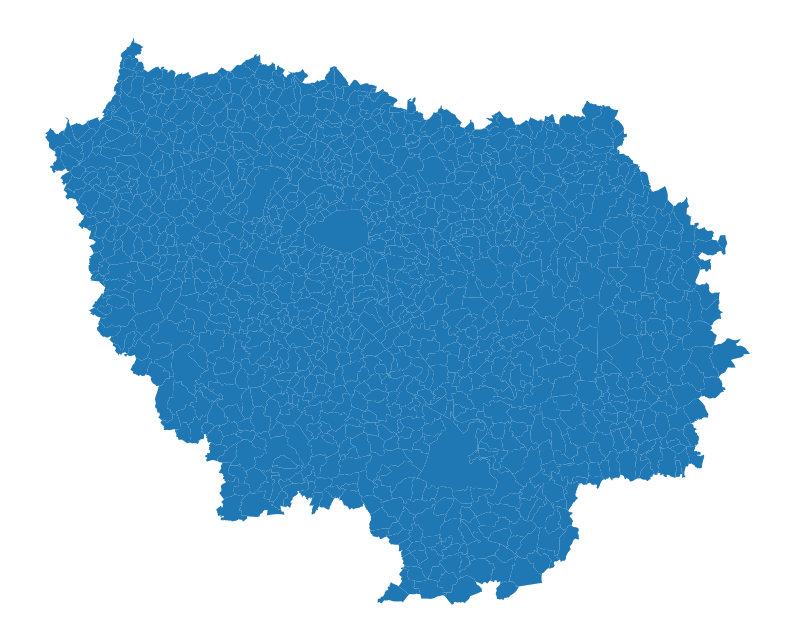

In [104]:
ax = communes_IDF.plot(figsize=(10,10))
ax.set_axis_off()

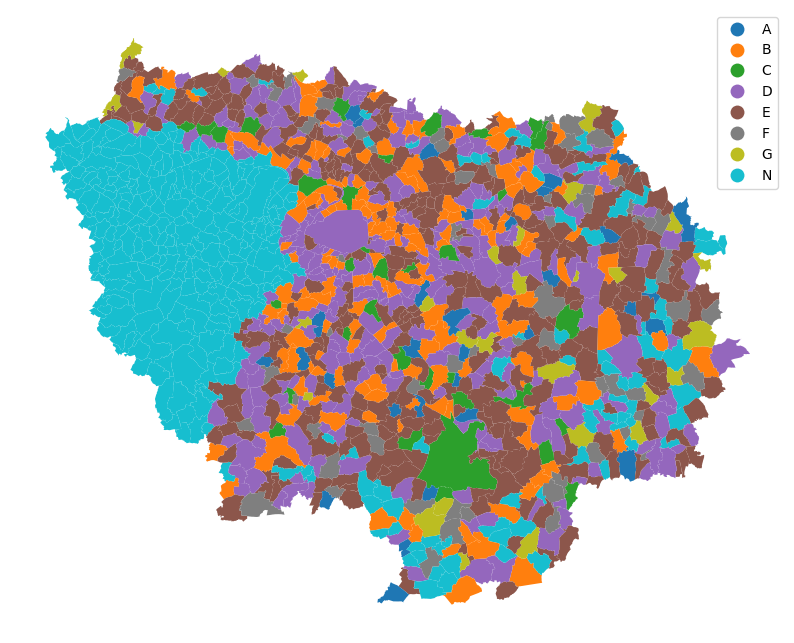

In [105]:
ax = data_used.plot(figsize=(10,10), column = 'CE_Maj', label = 'CE_Maj', legend = True)
ax.set_axis_off()

In [106]:
data_used.columns

Index(['ID', 'NOM', 'NOM_M', 'INSEE_COM', 'STATUT', 'POPULATION', 'INSEE_CAN',
       'INSEE_ARR', 'INSEE_DEP', 'INSEE_REG', 'SIREN_EPCI', 'geometry',
       'CODGEO', 'LIBGEO', 'NBMENFISC16', 'NBPERSMENFISC16', 'MED16', 'A', 'B',
       'C', 'D', 'E', 'F', 'G', 'Nombre de DPE', 'ratio_DPE_menage', 'CE_Maj'],
      dtype='object')

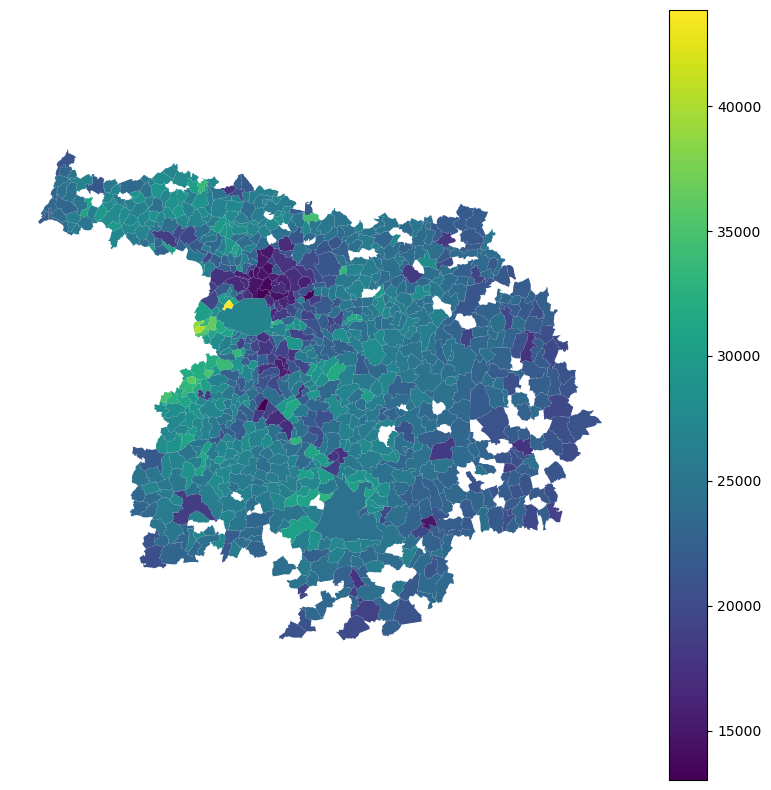

In [107]:
ax = data_used.plot(figsize=(10,10), column = 'MED16', legend = True)
ax.set_axis_off()

In [187]:
# Construction de cartes interactives

In [108]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [109]:
data_geo2 = communes_IDF[['INSEE_COM', 'geometry']]
data_geo2['Center_point'] = data_geo2['geometry'].centroid

/tmp/ipykernel_102480/4216355743.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  data_geo2['Center_point'] = data_geo2['geometry'].centroid
/opt/mamba/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [110]:
data_geo2.head()

,INSEE_COM,geometry,Center_point
0,75056,"POLYGON ((2.36420 48.81640, 2.36333 48.81615, ...",POINT (2.34292 48.85661)
0,91689,"POLYGON ((2.32487 48.71100, 2.32483 48.71105, ...",POINT (2.32953 48.72969)
1,91645,"POLYGON ((2.23862 48.73577, 2.23860 48.73578, ...",POINT (2.25211 48.75043)
2,91064,"POLYGON ((2.20405 48.73695, 2.20392 48.73697, ...",POINT (2.20645 48.75659)
3,91526,"POLYGON ((2.24623 48.32961, 2.24645 48.33008, ...",POINT (2.23720 48.34517)


In [111]:
#Extract lat and lon from the centerpoint
data_geo2["lat"] = data_geo2.Center_point.map(lambda p: p.x)
data_geo2["long"] = data_geo2.Center_point.map(lambda p: p.y)

/opt/mamba/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/mamba/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [112]:
data_geo2.head()

,INSEE_COM,geometry,Center_point,lat,long
0,75056,"POLYGON ((2.36420 48.81640, 2.36333 48.81615, ...",POINT (2.34292 48.85661),2.342919,48.856614
0,91689,"POLYGON ((2.32487 48.71100, 2.32483 48.71105, ...",POINT (2.32953 48.72969),2.329530,48.729693
1,91645,"POLYGON ((2.23862 48.73577, 2.23860 48.73578, ...",POINT (2.25211 48.75043),2.252107,48.750432
2,91064,"POLYGON ((2.20405 48.73695, 2.20392 48.73697, ...",POINT (2.20645 48.75659),2.206446,48.756590
3,91526,"POLYGON ((2.24623 48.32961, 2.24645 48.33008, ...",POINT (2.23720 48.34517),2.237202,48.345168


In [113]:
data_geo2['lat'].mean()

2.434222034493257

In [118]:
import folium

# Calcul du centre de la carte
data_geo2 = communes_IDF[['INSEE_COM', 'geometry']]
data_geo2['Center_point'] = data_geo2['geometry'].centroid
#Extract lat and lon from the centerpoint
data_geo2["lat"] = data_geo2.Center_point.map(lambda p: p.x)
data_geo2["long"] = data_geo2.Center_point.map(lambda p: p.y)

# Sortie de la carte primaire
m = folium.Map(location=[data_geo2['long'].mean(), data_geo2['lat'].mean()],
               zoom_start=9, tiles='cartodbpositron')
m

/tmp/ipykernel_102480/3448450139.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  data_geo2['Center_point'] = data_geo2['geometry'].centroid
/opt/mamba/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/mamba/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

In [119]:
data_geo = communes_IDF[['INSEE_COM', 'geometry']]
f_data = data_used[['INSEE_COM','POPULATION','MED16','A', 'B',
       'C', 'D', 'E', 'F', 'G', 'CE_Maj']]

In [120]:
folium.Choropleth(
    geo_data=communes_IDF,
    data = f_data,
    columns = ['INSEE_COM', 'MED16'],
    key_on = 'feature.properties.INSEE_COM',
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Revenu médian (€)"
    ).add_to(m)
m